In [3]:
import functools
from typing import Callable

import geopandas as gpd
import matplotlib as mpl
import numpy as np
import pandas as pd
from PIL import Image
import plotly
import plotly.express as px
import sqlite3

In [4]:
import matplotlib.pylab as plt
plt.rcParams['figure.dpi'] = 300

In [5]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

In [6]:
mpl.style.use('ggplot') 

In [7]:
px.set_mapbox_access_token(open("../.mapbox_token").read())

In [8]:
con = sqlite3.connect("data/permit.db")
cur = con.cursor()

In [9]:
cur.execute("SELECT name FROM sqlite_master WHERE type='table';").fetchall()

[('permit',)]

In [10]:
permits_all = pd.read_sql_query("SELECT * FROM permit", con, parse_dates=["issued_date", "application_date", "expiration_date", "completion_date", "final_date"])
permits_all.head(25)

,case_id,status,issued_date,application_date,expiration_date,completion_date,final_date,request_date,source_city,source_postal_code,source_full_address,geocoded_city,geocoded_postal_code,geocoded_latitude,geocoded_longitude,reason,destination
0,34fb46eb-46a0-4670-880a-94230f5484b8,Issued,2023-11-08 16:28:54+00:00,2023-11-08 16:28:18+00:00,2026-11-09 16:28:54+00:00,NaT,NaT,None,Henrico,23231,2841 Williamsburg Road Henrico VA 23231,Henrico County,23231,37.517365,-77.346959,MainExtension,Commercial
1,4100b90e-a4c9-499a-a29e-8b4e5d4db1b2,Issued,2023-10-13 13:41:18+00:00,2023-10-13 13:40:32+00:00,2026-10-12 13:41:18+00:00,NaT,NaT,None,Richmond,23231,4106 Williamsburg Road Richmond VA 23231,Henrico County,23231,37.518417,-77.357685,MainExtension,Commercial
2,518e7339-4884-4a8b-aefd-c1f760e41edd,Issued,2023-09-25 19:33:21+00:00,2023-09-25 19:31:57+00:00,2026-09-24 19:33:21+00:00,NaT,NaT,None,Richmond,23229,8899 River Road Richmond VA 23229,Henrico County,23229,37.568148,-77.587671,MainExtension,Residential
3,1fca4d8c-9342-4476-b1ba-ddcd9b6036a4,Issued,2023-12-21 20:30:44+00:00,2023-12-21 20:30:01+00:00,2026-12-21 20:30:44+00:00,NaT,NaT,None,Richmond,23233,12241 W Broad St C Richmond VA 23233,Henrico County,23233,37.659711,-77.637600,Addition,Commercial
4,114afe4f-0bc8-4d9d-b013-51515b85626a,Expired,2017-05-25 04:00:00+00:00,NaT,2019-07-08 04:00:00+00:00,NaT,2017-07-10 04:00:00+00:00,None,RICHMOND,23235,4004 MEADOWDALE Blvd RICHMOND VA 23235,Chesterfield County,23234,37.438203,-77.472917,Upgrade,Commercial
5,f5c93b52-c8ed-4cba-ba35-63322ce19ba4,Issued,2023-12-19 20:57:03+00:00,2023-12-19 20:56:21+00:00,2026-12-18 20:57:03+00:00,NaT,NaT,None,Henrico,23228,1632 E Parham Road Suite A Henrico VA 23228,Henrico County,23228,37.639644,-77.473023,New,Commercial
6,c036fe6d-154f-4ba2-88d9-ab4406d00d56,Issued,2023-08-07 15:45:19+00:00,2023-08-07 15:39:25+00:00,2026-08-06 15:45:19+00:00,NaT,NaT,None,Henrico,23233,13150 Old Three Chopt Road Henrico VA 23233,Henrico County,23233,37.650524,-77.611294,MainExtension,Commercial
7,1c7997f9-3616-4d4a-90ba-bf37552a2937,Issued,2023-12-04 05:00:00+00:00,2023-12-04 16:58:10+00:00,2024-06-03 17:12:05+00:00,NaT,NaT,None,Richmond,23221,304 St Davids Lane Richmond VA 23221,Richmond,23221,37.550525,-77.496726,HeavyRemodel,Residential
8,528d28e3-736c-458f-b0d3-56143885099b,Issued,2023-11-09 05:00:00+00:00,2023-11-09 15:57:49+00:00,2024-05-07 04:00:00+00:00,NaT,NaT,None,Richmond,23224,6255 Old Warwick Road Richmond VA 23224,Richmond,23224,37.489992,-77.486822,Addition,Commercial
9,371d4869-c0a9-4817-a92b-7a6db4871505,Finaled,2023-10-03 04:00:00+00:00,2023-10-03 18:26:49+00:00,2024-05-14 15:15:08+00:00,NaT,2024-01-02 17:40:11+00:00,None,Richmond,23220,1912 W Cary St Richmond VA 23220,Richmond,23220,37.548023,-77.465566,HeavyRemodel,Commercial


In [11]:
permits_all.shape

(97301, 17)

In [12]:
permits_all.value_counts("status")

status
Finaled            56856
Issued             24420
Expired            15524
Cancelled            166
Voided               150
Killed               104
Ready for Meter       33
On Hold               26
Withdrawn             19
Under Review           3
Name: count, dtype: int64

In [13]:
permits = permits_all[permits_all["status"].isin(["Finaled", "Issued", "Ready for Meter"])].copy()
permits.shape

(81309, 17)

In [14]:
permits.dtypes

case_id                              object
status                               object
issued_date             datetime64[ns, UTC]
application_date        datetime64[ns, UTC]
expiration_date         datetime64[ns, UTC]
completion_date              datetime64[ns]
final_date              datetime64[ns, UTC]
request_date                         object
source_city                          object
source_postal_code                   object
source_full_address                  object
geocoded_city                        object
geocoded_postal_code                 object
geocoded_latitude                   float64
geocoded_longitude                  float64
reason                               object
destination                          object
dtype: object

In [15]:
permits["issued_date"] = permits["issued_date"].fillna(permits["application_date"])
permits = permits.sort_values("issued_date")
permits["issued_day"] = permits["issued_date"].round("D")
permits["issued_month_date"] = permits["issued_date"].dt.to_period('M').dt.to_timestamp()
permits["issued_year_date"] = permits["issued_date"].dt.to_period('Y').dt.to_timestamp()
permits["issued_year"] = permits["issued_date"].dt.year.astype(int)
permits["issued_year_str"] = permits["issued_year"].astype(str)
permits["Year Issued"] = permits["issued_year_str"]

permits["pre-2008"] = permits["issued_year"].apply(lambda x: "1993-2007" if x < 2008 else "2008-Present")

permits["Location"] = permits["geocoded_city"].apply(lambda r: "Richmond" if r == "Richmond" else "Outside the city")
permits.head()

/var/folders/p0/54kr448x6679fjp6vzs43l440000gn/T/ipykernel_14133/2520265676.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  permits["issued_date"] = permits["issued_date"].fillna(permits["application_date"])
/var/folders/p0/54kr448x6679fjp6vzs43l440000gn/T/ipykernel_14133/2520265676.py:4: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  permits["issued_month_date"] = permits["issued_date"].dt.to_period('M').dt.to_timestamp()
/var/folders/p0/54kr448x6679fjp6vzs43l440000gn/T/ipykernel_14133/2520265676.py:5: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  permits["issued_year_date"] = permits["issued_date"].dt.to_period('Y').dt.to_timestamp()


,case_id,status,issued_date,application_date,expiration_date,completion_date,final_date,request_date,source_city,source_postal_code,source_full_address,geocoded_city,geocoded_postal_code,geocoded_latitude,geocoded_longitude,reason,destination,issued_day,issued_month_date,issued_year_date,issued_year,issued_year_str,Year Issued,pre-2008,Location
23312,149AD162-6876-4CC9-B45D-DA45EACF339C,Finaled,1993-04-02 05:00:00+00:00,1993-04-02 05:00:00+00:00,NaT,NaT,1993-04-23 04:00:00+00:00,None,None,23222,2303 2ND Ave 23222,Richmond,23222,37.563289,-77.423072,Addition,Residential,1993-04-02 00:00:00+00:00,1993-04-01,1993-01-01,1993,1993,1993,1993-2007,Richmond
31664,85265007-E229-4EC5-85BD-A6A1F570804F,Finaled,1993-04-02 05:00:00+00:00,1993-04-02 05:00:00+00:00,NaT,NaT,1994-09-06 04:00:00+00:00,None,None,23220,900 HERMITAGE Road 23220,Richmond,23220,37.559940,-77.460848,New,Commercial,1993-04-02 00:00:00+00:00,1993-04-01,1993-01-01,1993,1993,1993,1993-2007,Richmond
97300,F71634BA-3341-4893-B13A-BE9C656E4778,Finaled,1993-04-05 04:00:00+00:00,1993-04-05 04:00:00+00:00,NaT,NaT,1993-06-04 04:00:00+00:00,None,None,None,None,None,None,NaN,NaN,New,Residential,1993-04-05 00:00:00+00:00,1993-04-01,1993-01-01,1993,1993,1993,1993-2007,Outside the city
97299,A0B8890D-B541-4D09-82D1-500DF9DD7514,Finaled,1993-04-05 04:00:00+00:00,1993-04-05 04:00:00+00:00,NaT,NaT,1993-09-07 04:00:00+00:00,None,None,None,None,None,None,NaN,NaN,New,Residential,1993-04-05 00:00:00+00:00,1993-04-01,1993-01-01,1993,1993,1993,1993-2007,Outside the city
61819,F06110CE-0F25-4B9E-9BA4-1255C078AC98,Issued,1993-04-05 04:00:00+00:00,1993-04-05 04:00:00+00:00,NaT,NaT,NaT,None,None,23227,3911 BROOK Road 23227,Richmond,23227,37.589523,-77.451570,Upgrade,Residential,1993-04-05 00:00:00+00:00,1993-04-01,1993-01-01,1993,1993,1993,1993-2007,Richmond


In [16]:
permits.columns

Index(['case_id', 'status', 'issued_date', 'application_date',
       'expiration_date', 'completion_date', 'final_date', 'request_date',
       'source_city', 'source_postal_code', 'source_full_address',
       'geocoded_city', 'geocoded_postal_code', 'geocoded_latitude',
       'geocoded_longitude', 'reason', 'destination', 'issued_day',
       'issued_month_date', 'issued_year_date', 'issued_year',
       'issued_year_str', 'Year Issued', 'pre-2008', 'Location'],
      dtype='object')

In [17]:
permits['latitude'] = permits['geocoded_latitude']
permits['longitude'] = permits['geocoded_longitude']

permits_out = permits[
    ['case_id', 'status', 'issued_date', 'application_date',
       'expiration_date', 'completion_date', 'final_date', 'request_date',
       'source_city', 'source_postal_code', 'source_full_address',
       'geocoded_city', 'geocoded_postal_code', 'latitude',
       'longitude', 'reason', 'destination', 'issued_day',
       'issued_month_date', 'issued_year_date', 'issued_year',
       'issued_year_str', 'Year Issued', 'pre-2008', 'Location']
]

#permits_out.to_csv("./permits.csv")

In [18]:
residential = permits[permits['destination'] == "Residential"].copy()
residential['latitude3'] = residential['latitude'].round(3)
residential['longitude3'] = residential['longitude'].round(3)
residential['latitude2'] = residential['latitude'].round(2)
residential['longitude2'] = residential['longitude'].round(2)

In [19]:
residential_latlong3 = residential.groupby(['pre-2008', 'Location', 'latitude3', 'longitude3']).size().to_frame('Num Permits').reset_index()
residential_latlong3['dummy_size'] = 1
residential_latlong3.head()

,pre-2008,Location,latitude3,longitude3,Num Permits,dummy_size
0,1993-2007,Outside the city,26.239,-98.413,1,1
1,1993-2007,Outside the city,27.069,-82.238,1,1
2,1993-2007,Outside the city,28.536,-81.743,1,1
3,1993-2007,Outside the city,29.236,-81.054,1,1
4,1993-2007,Outside the city,30.294,-89.362,1,1


In [20]:
residential_latlong2 = residential.groupby(['pre-2008', 'Location', 'latitude2', 'longitude2']).size().to_frame('Num Permits').reset_index()
residential_latlong2['dummy_size'] = 1
residential_latlong2.head()

,pre-2008,Location,latitude2,longitude2,Num Permits,dummy_size
0,1993-2007,Outside the city,26.24,-98.41,1,1
1,1993-2007,Outside the city,27.07,-82.24,1,1
2,1993-2007,Outside the city,28.54,-81.74,1,1
3,1993-2007,Outside the city,29.24,-81.05,1,1
4,1993-2007,Outside the city,30.29,-89.36,1,1


---

# Plots

<Axes: xlabel='destination'>

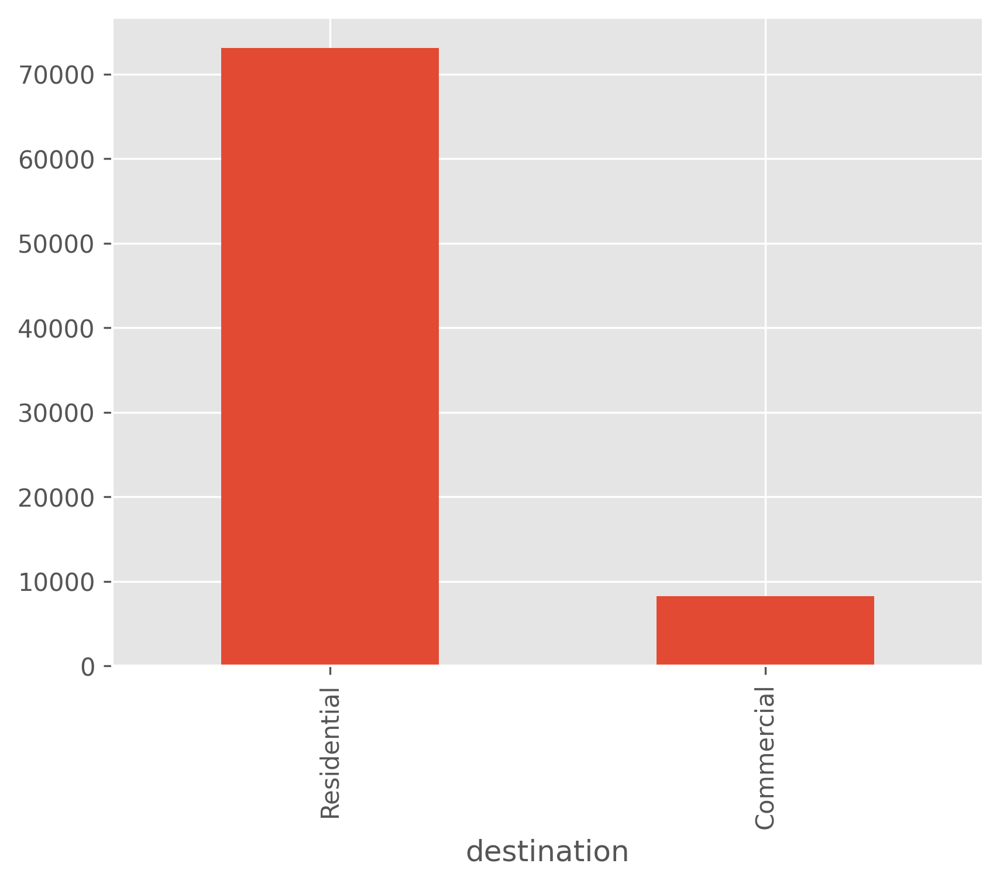

In [22]:
permits["destination"].value_counts().plot(kind="bar")

<Axes: xlabel='status'>

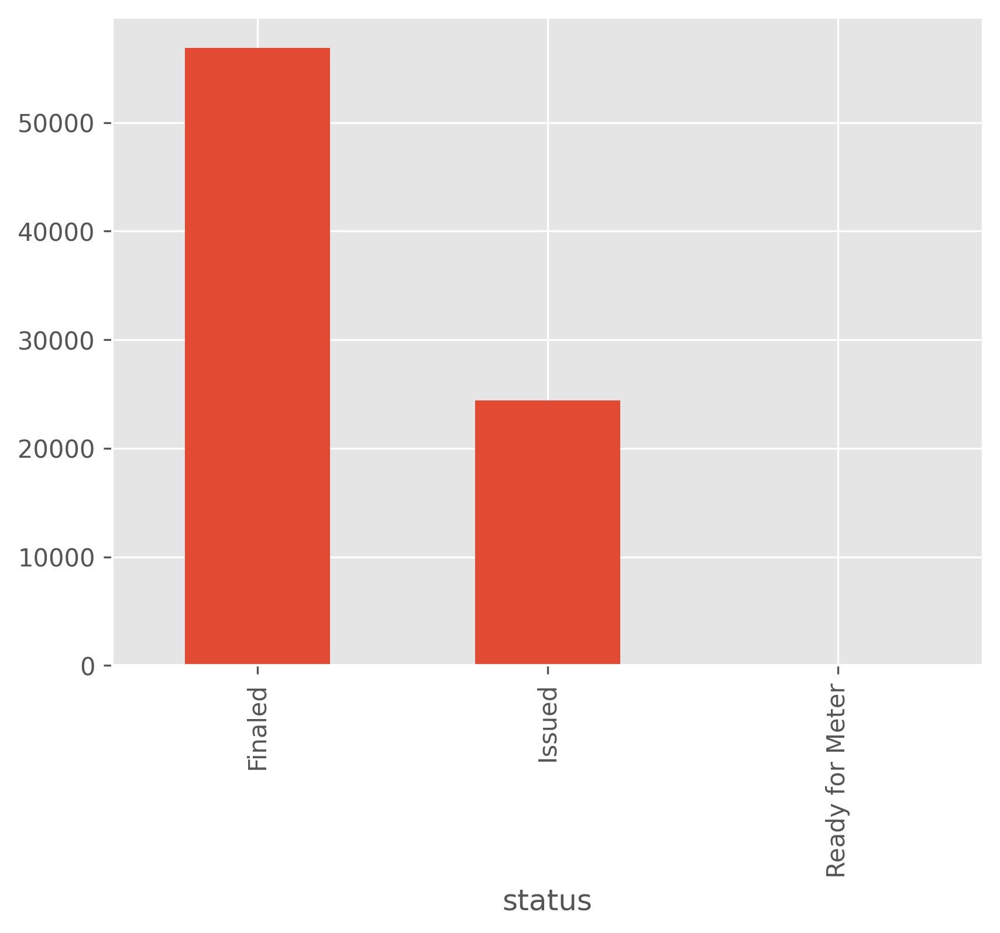

In [23]:
permits["status"].value_counts().plot(kind="bar")

<Axes: xlabel='geocoded_city'>

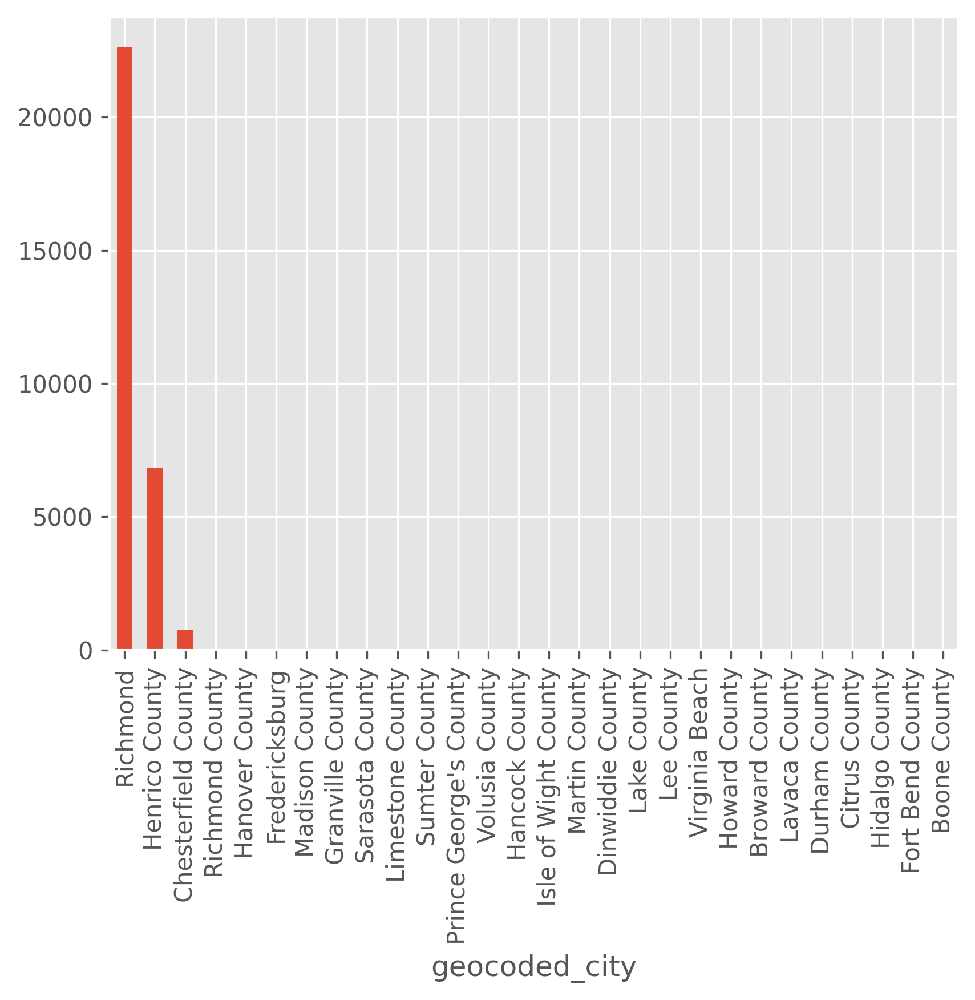

In [24]:
permits["geocoded_city"].value_counts().plot(kind="bar")

In [31]:
permits.groupby(by=["reason", "geocoded_city"]).size()

reason         geocoded_city         
Accessory      Richmond                    41
Addition       Chesterfield County         49
               Fort Bend County             1
               Hanover County               2
               Henrico County             567
               Madison County               3
               Richmond                   955
               Richmond County              2
               Sumter County                1
HeavyRemodel   Chesterfield County          1
               Henrico County               1
               Richmond                   220
LightRemodel   Chesterfield County         36
               Fredericksburg               1
               Henrico County              64
               Limestone County             1
               Martin County                1
               Prince George's County       2
               Richmond                  5192
               Richmond County              1
               Sarasota County            

<Axes: xlabel='reason'>

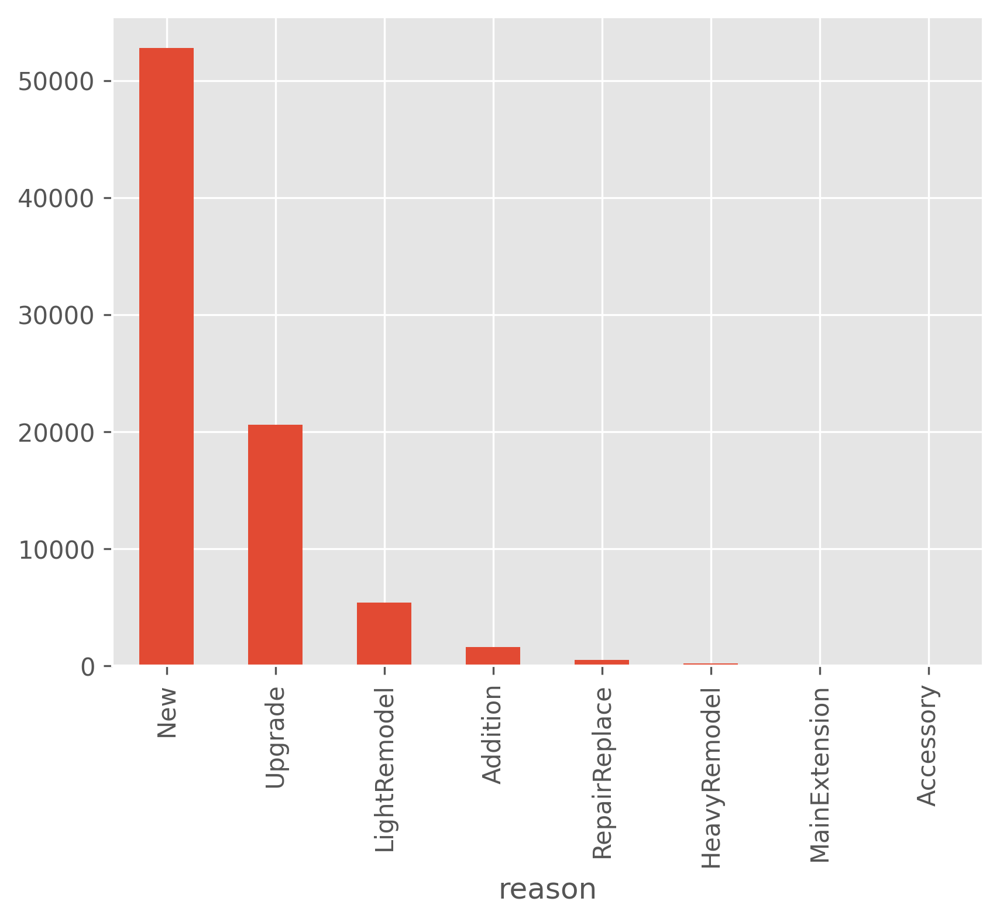

In [32]:
permits["reason"].value_counts().plot(kind="bar")

<Axes: xlabel='reason'>

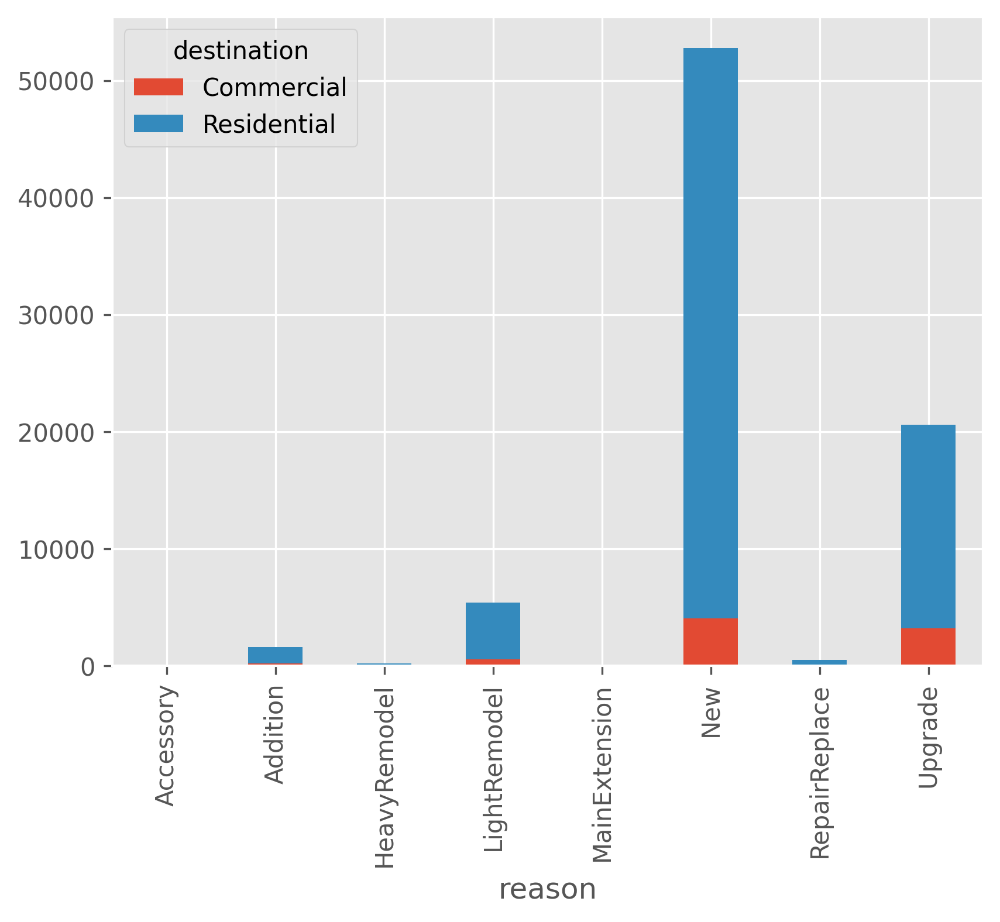

In [33]:
permits.groupby(by=["reason", "destination"]).size().unstack().plot(kind="bar", stacked=True)

<Axes: xlabel='issued_month_date'>

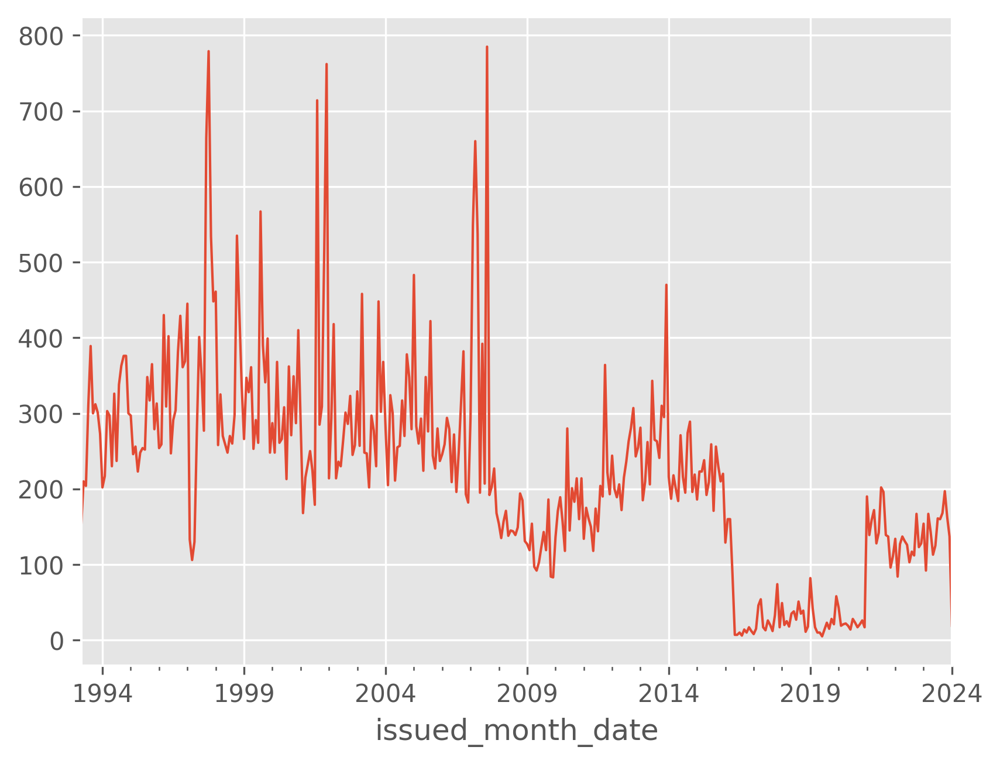

In [34]:
permits.groupby(["issued_month_date"]).size().plot(kind="line", lw=1)

<Axes: xlabel='issued_month_date'>

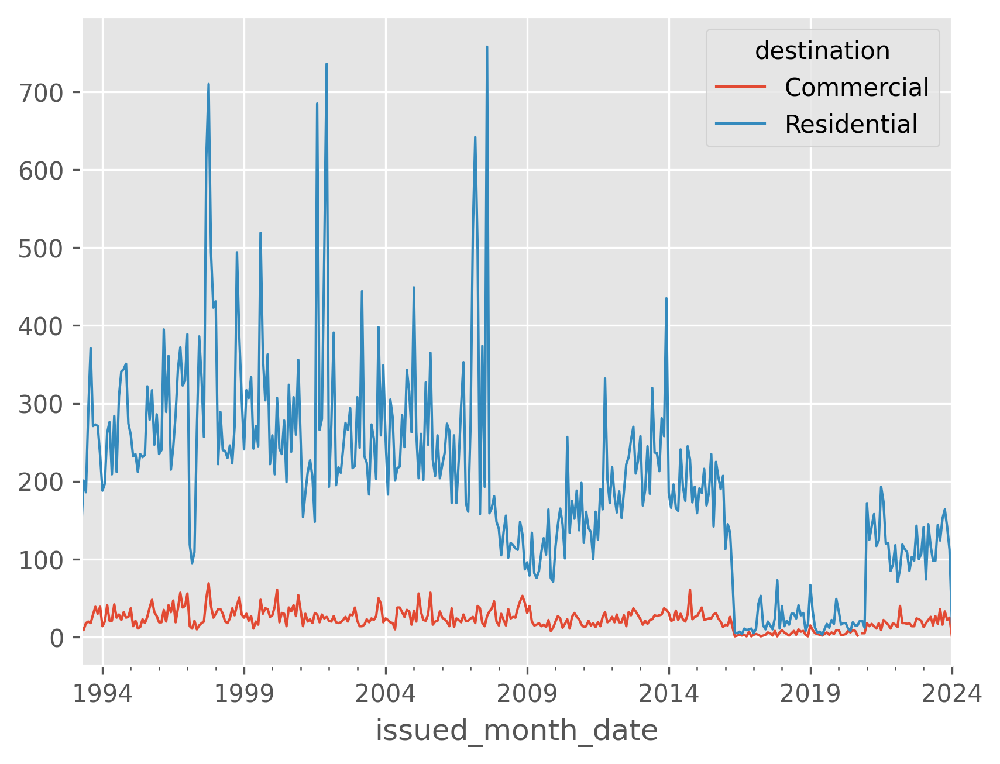

In [35]:
permits.groupby(["issued_month_date", "destination"]).size().unstack().plot(lw=1)

<Axes: xlabel='issued_month_date'>

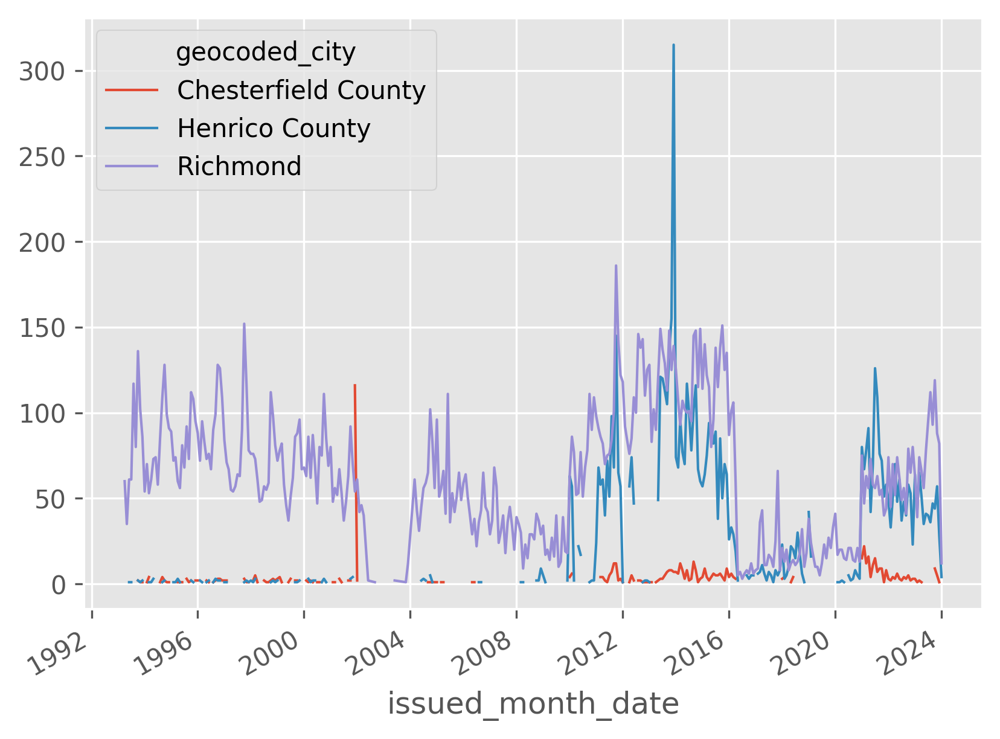

In [36]:
permits[permits["geocoded_city"].isin(["Richmond", "Chesterfield County", "Henrico County"])].groupby(["issued_month_date", "geocoded_city"]).size().unstack().plot(lw=1)

<Axes: xlabel='issued_month_date'>

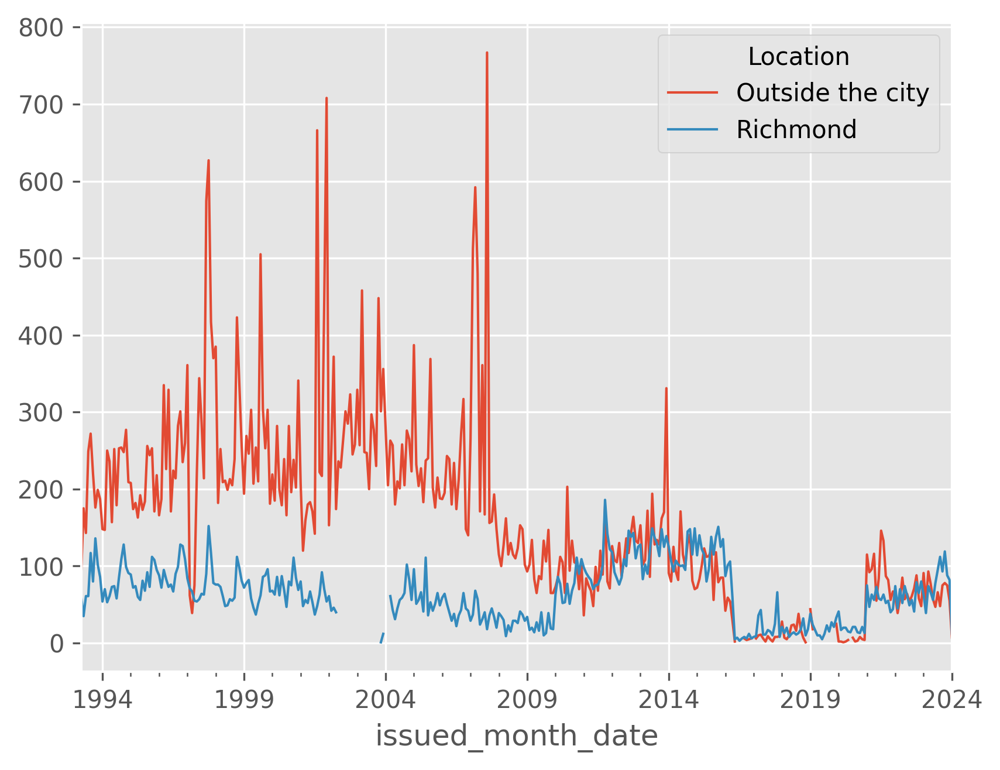

In [37]:
permits.groupby(["issued_month_date", "Location"]).size().unstack().plot(lw=1)

<Axes: xlabel='issued_year'>

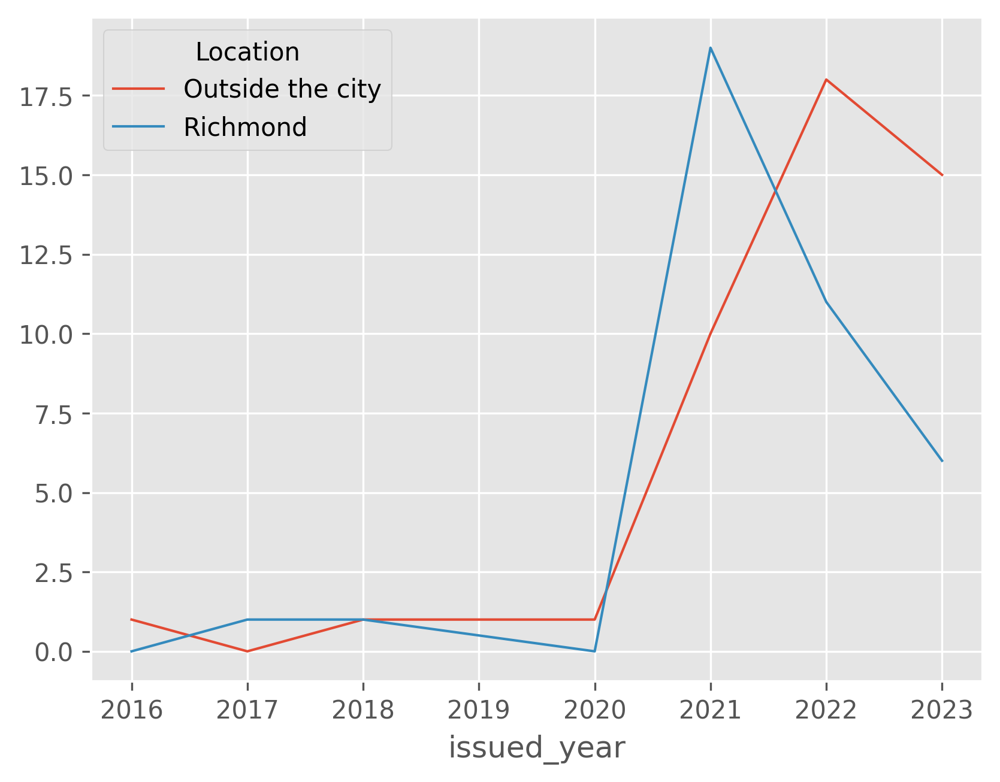

In [38]:
permits[(permits["reason"] == "MainExtension")].groupby(["issued_year", "Location"]).size().unstack().fillna(0).plot(lw=1)

In [61]:
plot_df = residential_latlong3[
    (residential_latlong3['pre-2008'] == '1993-2007') & (residential_latlong3['Location'] == 'Outside the city')
]

fig = px.scatter_mapbox(
    plot_df, 
    title="Dot Grid Map",
    lat="latitude3", lon="longitude3",
    #color="Num Permits",
    opacity=1,
    size="Num Permits",
    #size_max=1.5,
    color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [40]:
residential_latlong2[
    (residential_latlong2['pre-2008'] == '1993-2007') & (residential_latlong2['Location'] == 'Outside the city')
]

,pre-2008,Location,latitude2,longitude2,Num Permits,dummy_size
0,1993-2007,Outside the city,26.24,-98.41,1,1
1,1993-2007,Outside the city,27.07,-82.24,1,1
2,1993-2007,Outside the city,28.54,-81.74,1,1
3,1993-2007,Outside the city,29.24,-81.05,1,1
4,1993-2007,Outside the city,30.29,-89.36,1,1
5,1993-2007,Outside the city,34.69,-86.79,1,1
6,1993-2007,Outside the city,36.29,-78.58,2,1
7,1993-2007,Outside the city,36.31,-78.55,1,1
8,1993-2007,Outside the city,36.98,-76.61,1,1
9,1993-2007,Outside the city,37.09,-77.58,1,1


In [60]:
plot_df = residential_latlong2[
    (residential_latlong2['pre-2008'] == '1993-2007') & (residential_latlong2['Location'] == 'Outside the city')
]

fig = px.scatter_mapbox(
    plot_df, 
    title="Outside - Pre 2008",
    lat="latitude2", lon="longitude2",
    center={"lat":37.556518, "lon":-77.481927},
    #color="Num Permits",
    opacity=1,
    size="Num Permits",
    #size_max=3,
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [62]:
plot_df = residential_latlong2[
    (residential_latlong2['pre-2008'] == '2008-Present') & (residential_latlong2['Location'] == 'Outside the city')
]

fig = px.scatter_mapbox(
    plot_df, 
    title="Dot Grid Map",
    lat="latitude2", lon="longitude2",
    center={"lat":37.556518, "lon":-77.481927},
    #color="Num Permits",
    opacity=1,
    size="Num Permits",
    #size_max=3,
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [75]:
# Need to make only new connections

plot_df = residential_latlong2[
    (residential_latlong2['Location'] == 'Outside the city')
]

fig = px.scatter_mapbox(
    residential_latlong2, 
    title="Dot Grid Map",
    lat="latitude2", lon="longitude2",
    center={"lat":37.556518, "lon":-77.481927},
    animation_frame="pre-2008",
    color="Location",
    opacity=1,
    size="Num Permits",
    size_max=10,
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [76]:
fig = px.scatter_mapbox(
    residential_latlong2, 
    title="Dot Grid Map",
    lat="latitude2", lon="longitude2",
    #color="Location",
    opacity=0.2,
    #size="car_hours",
    color_continuous_scale=px.colors.cyclical.IceFire, 
    #size_max=15, 
    zoom=9)

fig.show()

In [77]:
fig = px.scatter_mapbox(
    permits, 
    title="Permits by Location",
    lat="geocoded_latitude", lon="geocoded_longitude",
    color="Location",
    opacity=0.2,
    #size="car_hours",
    color_continuous_scale=px.colors.cyclical.IceFire, 
    #size_max=15, 
    zoom=9)

fig.show()

In [46]:
fig = px.scatter_mapbox(
    permits, 
    title="Permits by Issued Year",
    lat="geocoded_latitude", lon="geocoded_longitude",
    color="issued_year",
    opacity=0.2,
    #size="car_hours",
    color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [78]:
fig = px.scatter_mapbox(
    permits[permits["reason"] == "MainExtension"], 
    title="Main Extensions",
    lat="geocoded_latitude", lon="geocoded_longitude",
    color="reason",
    opacity=0.8,
    zoom=9)

fig.show()

In [48]:
fig = px.scatter_mapbox(
    permits[permits["reason"] == "MainExtension"], 
    title="Main Extensions - Residential and Commercial",
    lat="geocoded_latitude", lon="geocoded_longitude",
    color="destination",
    opacity=1,
    zoom=9)

fig.show()

In [79]:
fig = px.scatter_mapbox(
    permits,
    title="Permits - Residential and Commercial",
    lat="geocoded_latitude", lon="geocoded_longitude",
    color="destination",
    opacity=0.1,
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [63]:
fig = px.density_mapbox(
    permits[permits["issued_year"].isin([2020, 2021, 2022, 2023])], 
    title="Permit Density - 2020-2023",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=2,
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [51]:
fig = px.density_mapbox(
    permits, 
    title="Permit Density",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=1,
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [80]:
fig = px.density_mapbox(
    permits,
    title="Permit Density: 1993 to Present",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=3,
    animation_frame="Year Issued",
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [66]:
fig = px.density_mapbox(
    permits[permits["reason"] == "New"],
    title="Permit Density: 1993 to Present",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=3,
    animation_frame="Year Issued",
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [81]:
fig = px.density_mapbox(
    permits[permits["reason"] == "New"],
    title="New Permits: Before & After 2008",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=2,
    animation_frame="pre-2008",
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [67]:
fig = px.scatter_mapbox(
    permits, 
    title="Permits: 1993 to 2022",
    lat="geocoded_latitude", lon="geocoded_longitude",
    animation_frame="Year Issued",
    opacity=0.4,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [68]:
fig = px.scatter_mapbox(
    permits[permits["reason"] == "MainExtension"], 
    lat="geocoded_latitude", lon="geocoded_longitude",
    animation_frame="Year Issued",
    opacity=0.9,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [57]:
permits_all.groupby(by=["reason", "status"]).size()

reason         status         
Accessory      Expired              118
               Finaled                8
               Issued                33
Addition       Cancelled             14
               Expired             2543
               Finaled              547
               Issued              1086
               Killed                 4
               On Hold                2
               Ready for Meter        1
               Voided                38
               Withdrawn              2
HeavyRemodel   Cancelled              1
               Expired              276
               Finaled              178
               Issued                55
               Killed                 3
LightRemodel   Expired             3696
               Finaled             3768
               Issued              1663
               Killed                64
               Under Review           2
               Voided                 3
               Withdrawn              7
MainExten

In [58]:
permits.groupby(by=["reason", "status", "Location"]).size()

reason         status           Location        
Accessory      Finaled          Richmond                8
               Issued           Richmond               33
Addition       Finaled          Outside the city      116
                                Richmond              431
               Issued           Outside the city      563
                                Richmond              523
               Ready for Meter  Richmond                1
HeavyRemodel   Finaled          Outside the city       13
                                Richmond              165
               Issued           Richmond               55
LightRemodel   Finaled          Outside the city      172
                                Richmond             3596
               Issued           Outside the city       67
                                Richmond             1596
MainExtension  Finaled          Outside the city        7
                                Richmond                2
               Issued  

In [59]:
fig = px.scatter_mapbox(
    permits[(permits["reason"] == "MainExtension") & (permits["status"] == "Issued")], 
    lat="geocoded_latitude", lon="geocoded_longitude",
    #animation_frame="issued_year",
    opacity=1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [89]:
fig = px.scatter_mapbox(
    permits[(permits["Location"] == "Outside the city") ], 
    title="Permits Outside the City",
    lat="geocoded_latitude", lon="geocoded_longitude",
    animation_frame="Year Issued",
    opacity=0.3,
    center={"lat":37.556518, "lon":-77.481927},
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [73]:
fig = px.scatter_mapbox(
    permits[(permits["reason"] == "New") ], 
    title="Permits: New",
    lat="geocoded_latitude", lon="geocoded_longitude",
    animation_frame="Year Issued",
    opacity=0.3,
    center={"lat":37.556518, "lon":-77.481927},
    color='Location',
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [74]:
fig = px.density_mapbox(
    permits[(permits["Location"] == "Outside the city") ],
    title="Permits Outside the City: 1993 to 2022",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=4,
    animation_frame="Year Issued",
    center={"lat":37.556518, "lon":-77.481927},
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.OrRd, 
    #size_max=15, 
    zoom=9,
)

#fig.update_layout(coloraxis_showscale=False)
fig.update_layout(coloraxis_colorbar=dict(
    title="",
    tickvals=[0,1],
    ticktext=["Fewer", "More"],
))
fig.show()

In [70]:
fig = px.density_mapbox(
    permits[(permits["Location"] == "Outside the city") & (permits["reason"] == "New")],
    title="Permits Outside the City: Before and After 2008",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=3,
    animation_frame="pre-2008",
    center={"lat":37.556518, "lon":-77.481927},
    zoom=9,
)

fig.show()

In [38]:
permits[permits["issued_date"].isna()]

,status,issued_date,application_date,expiration_date,completion_date,final_date,request_date,source_city,source_postal_code,source_full_address,...,reason,destination,issued_day,issued_month_date,issued_year_date,issued_year,issued_year_str,Year Issued,pre-2008,Location


In [39]:
permits["final_date"][permits["issued_date"].isna()]

Series([], Name: final_date, dtype: datetime64[ns, UTC])

In [180]:
def make_gif(image_names:list[str], dir:str="images", duration=1000) -> str:
    """Take list of image file names and create a gif, the name of which is returned"""
    image_name_gif = f"{dir}/{image_names[0][:-4]}.gif"
    images = [Image.open(f"{dir}/{image_name}") for image_name in image_names]
    
    
    images[0].save(image_name_gif, save_all=True, append_images=images[1:], duration=duration, loop=0)
    print(f"Saved gif to: {image_name_gif}")
    
    return image_name_gif


# TODO: wrapper of a plot_fn(df) that takes the df and splits it by year
# then plots each year, saves it as a png and writes all pngs to disk

# pass sort order for iter column?
def run_plot_iteration_and_gif(
    df : pd.DataFrame,
    title_prefix : str,
    plot_fn : Callable, 
    plot_args : dict, 
    image_name : str, 
    image_dir : str = "images",
    iteration_column : str = "Year Issued",
    duration=1000,
    show_colorscale=True,
) -> str:
    
    iteration_values = df[iteration_column].unique()

    iteration_names = [f"{image_name}_{iteration_column}-{iteration_value}.png" for iteration_value in iteration_values]
    print(iteration_names)
    
    for iteration_value, iteration_name in zip(iteration_values, iteration_names):
        print(f"Iteration value: {iteration_value} | iteration name: {iteration_name}")
        df_iteration = df[df[iteration_column] == iteration_value]
        fig = plot_fn(df_iteration, title=f"{title_prefix}{iteration_value}", **plot_args)
        
        if not show_colorscale:
            fig.update_layout(coloraxis_showscale=False)
        
        fig.write_image(f"{image_dir}/{iteration_name}")
    
    gif_name = make_gif(iteration_names, image_dir, duration)
    
    return gif_name


def run_plot_iteration_sticky_and_gif(
    df : pd.DataFrame,
    title_prefix : str,
    plot_fn : Callable, 
    plot_args : dict, 
    image_name : str, 
    image_dir : str = "images",
    iteration_column : str = "Year Issued",
    duration=1000,
    show_legend=True,
    max_lag=2,
) -> str:
    
    iteration_values = df[iteration_column].unique()

    iteration_names = [f"{image_name}_{iteration_column}-{iteration_value}.png" for iteration_value in iteration_values]
    print(iteration_names)
    
    for iteration_value, iteration_name in zip(iteration_values, iteration_names):
        print(f"Iteration value: {iteration_value} | iteration name: {iteration_name}")
        
        df_iteration = df[df[iteration_column] <= iteration_value].copy()
        max_year = df_iteration["issued_year"].max()
        df_iteration["lag"] = np.minimum(max_year - df_iteration["issued_year"], max_lag).astype(str)
        fig = plot_fn(df_iteration, title=f"{title_prefix}{iteration_value}", **plot_args)
        
        fig.update_layout(showlegend=show_legend)
        
        fig.write_image(f"{image_dir}/{iteration_name}")
    
    gif_name = make_gif(iteration_names, image_dir, duration)
    
    return gif_name

In [167]:
# dmb = density_mapbox
# smb = scatter_mapbox
def plot_dmb_permits(
    df:pd.DataFrame, 
    title:str="Permits: ",
    radius:int=2,
    zoom:int=9,
):
    fig = px.density_mapbox(
        df,
        title=title,
        lat="geocoded_latitude", lon="geocoded_longitude",
        radius=radius,
        center={"lat":37.556518, "lon":-77.481927},
        zoom=zoom
    )
    
    fig.update_layout(coloraxis_colorbar=dict(
        title="",
        tickvals=[0,1],
        ticktext=["Fewer", "More"],
    ))

    return fig


def plot_smb_permits(
    df:pd.DataFrame, 
    title:str="Permits: ",
    radius:int=2,
    zoom:int=9,
    opacity:float=0.1,
    color=None,
    color_discrete_map=None,
):
    fig = px.scatter_mapbox(
        df,
        title=title,
        lat="geocoded_latitude", lon="geocoded_longitude",
        center={"lat":37.556518, "lon":-77.481927},
        opacity=opacity,
        zoom=zoom,
        color=color,
        color_discrete_map=color_discrete_map,
    )

    return fig

In [116]:
plot_args = {
    
}
run_plot_iteration_and_gif(
    permits[permits["reason"] == "New"],
    "New Connection Permits: ",
    plot_dmb_permits, 
    plot_args, 
    image_name="NewBefore2008 - heatmap",
    iteration_column="pre-2008"
)

['NewBefore2008 - heatmap_pre-2008-1993-2007.png', 'NewBefore2008 - heatmap_pre-2008-2008-Present.png']
Iteration value: 1993-2007 | iteration name: NewBefore2008 - heatmap_pre-2008-1993-2007.png
Iteration value: 2008-Present | iteration name: NewBefore2008 - heatmap_pre-2008-2008-Present.png
Saved gif to: images/NewBefore2008 - heatmap_pre-2008-1993-2007.gif


'images/NewBefore2008 - heatmap_pre-2008-1993-2007.gif'

In [117]:
plot_args = {
    
}
run_plot_iteration_and_gif(
    permits,
    "Permits: ",
    plot_dmb_permits, 
    plot_args, 
    image_name="Before2008 - heatmap",
    iteration_column="pre-2008"
)

['Before2008 - heatmap_pre-2008-1993-2007.png', 'Before2008 - heatmap_pre-2008-2008-Present.png']
Iteration value: 1993-2007 | iteration name: Before2008 - heatmap_pre-2008-1993-2007.png
Iteration value: 2008-Present | iteration name: Before2008 - heatmap_pre-2008-2008-Present.png
Saved gif to: images/Before2008 - heatmap_pre-2008-1993-2007.gif


'images/Before2008 - heatmap_pre-2008-1993-2007.gif'

In [118]:
plot_args = {
    
}
run_plot_iteration_and_gif(
    permits,
    "Permits: ",
    plot_dmb_permits, 
    plot_args, 
    image_name="Permits - heatmap",
    iteration_column="Year Issued",
    duration=500,
)

['Permits - heatmap_Year Issued-1993.png', 'Permits - heatmap_Year Issued-1994.png', 'Permits - heatmap_Year Issued-1995.png', 'Permits - heatmap_Year Issued-1996.png', 'Permits - heatmap_Year Issued-1997.png', 'Permits - heatmap_Year Issued-1998.png', 'Permits - heatmap_Year Issued-1999.png', 'Permits - heatmap_Year Issued-2000.png', 'Permits - heatmap_Year Issued-2001.png', 'Permits - heatmap_Year Issued-2002.png', 'Permits - heatmap_Year Issued-2003.png', 'Permits - heatmap_Year Issued-2004.png', 'Permits - heatmap_Year Issued-2005.png', 'Permits - heatmap_Year Issued-2006.png', 'Permits - heatmap_Year Issued-2007.png', 'Permits - heatmap_Year Issued-2008.png', 'Permits - heatmap_Year Issued-2009.png', 'Permits - heatmap_Year Issued-2010.png', 'Permits - heatmap_Year Issued-2011.png', 'Permits - heatmap_Year Issued-2012.png', 'Permits - heatmap_Year Issued-2013.png', 'Permits - heatmap_Year Issued-2014.png', 'Permits - heatmap_Year Issued-2015.png', 'Permits - heatmap_Year Issued-20

'images/Permits - heatmap_Year Issued-1993.gif'

In [119]:
plot_args = {
    #"title": "New Permits: Before & After 2008",
}
run_plot_iteration_and_gif(
    permits,
    "Permits: ",
    plot_smb_permits, 
    plot_args, 
    image_name="Permits - scatter",
    iteration_column="Year Issued",
    duration=500,
)

['Permits - scatter_Year Issued-1993.png', 'Permits - scatter_Year Issued-1994.png', 'Permits - scatter_Year Issued-1995.png', 'Permits - scatter_Year Issued-1996.png', 'Permits - scatter_Year Issued-1997.png', 'Permits - scatter_Year Issued-1998.png', 'Permits - scatter_Year Issued-1999.png', 'Permits - scatter_Year Issued-2000.png', 'Permits - scatter_Year Issued-2001.png', 'Permits - scatter_Year Issued-2002.png', 'Permits - scatter_Year Issued-2003.png', 'Permits - scatter_Year Issued-2004.png', 'Permits - scatter_Year Issued-2005.png', 'Permits - scatter_Year Issued-2006.png', 'Permits - scatter_Year Issued-2007.png', 'Permits - scatter_Year Issued-2008.png', 'Permits - scatter_Year Issued-2009.png', 'Permits - scatter_Year Issued-2010.png', 'Permits - scatter_Year Issued-2011.png', 'Permits - scatter_Year Issued-2012.png', 'Permits - scatter_Year Issued-2013.png', 'Permits - scatter_Year Issued-2014.png', 'Permits - scatter_Year Issued-2015.png', 'Permits - scatter_Year Issued-20

'images/Permits - scatter_Year Issued-1993.gif'

In [120]:
plot_args = {
    #"title": "New Permits: Before & After 2008",
}
run_plot_iteration_and_gif(
    permits[permits["reason"] == "New"],
    "New Connection Permits: ",
    plot_smb_permits, 
    plot_args, 
    image_name="New Permits - scatter",
    iteration_column="Year Issued",
    duration=500,
)

['New Permits - scatter_Year Issued-1993.png', 'New Permits - scatter_Year Issued-1994.png', 'New Permits - scatter_Year Issued-1995.png', 'New Permits - scatter_Year Issued-1996.png', 'New Permits - scatter_Year Issued-1997.png', 'New Permits - scatter_Year Issued-1998.png', 'New Permits - scatter_Year Issued-1999.png', 'New Permits - scatter_Year Issued-2000.png', 'New Permits - scatter_Year Issued-2001.png', 'New Permits - scatter_Year Issued-2002.png', 'New Permits - scatter_Year Issued-2003.png', 'New Permits - scatter_Year Issued-2004.png', 'New Permits - scatter_Year Issued-2005.png', 'New Permits - scatter_Year Issued-2006.png', 'New Permits - scatter_Year Issued-2007.png', 'New Permits - scatter_Year Issued-2008.png', 'New Permits - scatter_Year Issued-2009.png', 'New Permits - scatter_Year Issued-2010.png', 'New Permits - scatter_Year Issued-2011.png', 'New Permits - scatter_Year Issued-2012.png', 'New Permits - scatter_Year Issued-2013.png', 'New Permits - scatter_Year Issue

'images/New Permits - scatter_Year Issued-1993.gif'

In [121]:
plot_args = {
    #"title": "New Permits: Before & After 2008",
}
run_plot_iteration_and_gif(
    permits[permits["reason"] == "New"],
    "New Connection Permits: ",
    plot_smb_permits, 
    plot_args, 
    image_name="New Permits Before 2008 - scatter",
    iteration_column="pre-2008",
    duration=1000,
)

['New Permits Before 2008 - scatter_pre-2008-1993-2007.png', 'New Permits Before 2008 - scatter_pre-2008-2008-Present.png']
Iteration value: 1993-2007 | iteration name: New Permits Before 2008 - scatter_pre-2008-1993-2007.png
Iteration value: 2008-Present | iteration name: New Permits Before 2008 - scatter_pre-2008-2008-Present.png
Saved gif to: images/New Permits Before 2008 - scatter_pre-2008-1993-2007.gif


'images/New Permits Before 2008 - scatter_pre-2008-1993-2007.gif'

In [122]:
plot_args = {
    #"title": "New Permits: Before & After 2008",
}
run_plot_iteration_and_gif(
    permits[(permits["Location"] == "Outside the city") & (permits["reason"] == "New")],
    "New Connection Permits Outside the City: ",
    plot_smb_permits, 
    plot_args, 
    image_name="New Permits Outside the City Before 2008 - scatter",
    iteration_column="pre-2008",
    duration=1000,
)

['New Permits Outside the City Before 2008 - scatter_pre-2008-1993-2007.png', 'New Permits Outside the City Before 2008 - scatter_pre-2008-2008-Present.png']
Iteration value: 1993-2007 | iteration name: New Permits Outside the City Before 2008 - scatter_pre-2008-1993-2007.png
Iteration value: 2008-Present | iteration name: New Permits Outside the City Before 2008 - scatter_pre-2008-2008-Present.png
Saved gif to: images/New Permits Outside the City Before 2008 - scatter_pre-2008-1993-2007.gif


'images/New Permits Outside the City Before 2008 - scatter_pre-2008-1993-2007.gif'

In [123]:
plot_args = {
    
}
run_plot_iteration_and_gif(
    permits[(permits["Location"] == "Outside the city") & (permits["reason"] == "New")],
    "New Connection Permits Outside the City: ",
    plot_dmb_permits, 
    plot_args, 
    image_name="New Permits Outside the City Before 2008 - heatmap",
    iteration_column="pre-2008",
    duration=1000,
)

['New Permits Outside the City Before 2008 - heatmap_pre-2008-1993-2007.png', 'New Permits Outside the City Before 2008 - heatmap_pre-2008-2008-Present.png']
Iteration value: 1993-2007 | iteration name: New Permits Outside the City Before 2008 - heatmap_pre-2008-1993-2007.png
Iteration value: 2008-Present | iteration name: New Permits Outside the City Before 2008 - heatmap_pre-2008-2008-Present.png
Saved gif to: images/New Permits Outside the City Before 2008 - heatmap_pre-2008-1993-2007.gif


'images/New Permits Outside the City Before 2008 - heatmap_pre-2008-1993-2007.gif'

In [183]:
plot_args = {
    "color_discrete_map" : {
        "0": "#08306b",
        "1": "#2171b5",
        "2": "#6baed6",
        "3": "#c6dbef",
        "4": "#f7fbff"},
    "color": "lag",
    "opacity": 0.3,
}

run_plot_iteration_sticky_and_gif(
    permits[(permits["reason"] == "New")],
    "New Connection Permits: ",
    plot_smb_permits, 
    plot_args, 
    image_name="New Permits - scatter - sticky",
    iteration_column="Year Issued",
    duration=750,
    show_legend=False,
    max_lag=2
)

['New Permits - scatter - sticky_Year Issued-1993.png', 'New Permits - scatter - sticky_Year Issued-1994.png', 'New Permits - scatter - sticky_Year Issued-1995.png', 'New Permits - scatter - sticky_Year Issued-1996.png', 'New Permits - scatter - sticky_Year Issued-1997.png', 'New Permits - scatter - sticky_Year Issued-1998.png', 'New Permits - scatter - sticky_Year Issued-1999.png', 'New Permits - scatter - sticky_Year Issued-2000.png', 'New Permits - scatter - sticky_Year Issued-2001.png', 'New Permits - scatter - sticky_Year Issued-2002.png', 'New Permits - scatter - sticky_Year Issued-2003.png', 'New Permits - scatter - sticky_Year Issued-2004.png', 'New Permits - scatter - sticky_Year Issued-2005.png', 'New Permits - scatter - sticky_Year Issued-2006.png', 'New Permits - scatter - sticky_Year Issued-2007.png', 'New Permits - scatter - sticky_Year Issued-2008.png', 'New Permits - scatter - sticky_Year Issued-2009.png', 'New Permits - scatter - sticky_Year Issued-2010.png', 'New Perm

'images/New Permits - scatter - sticky_Year Issued-1993.gif'

In [131]:
print(len(px.colors.sequential.Blues))

9


In [130]:
px.colors.get_colorscale("blues")

[[0.0, 'rgb(247,251,255)'],
 [0.125, 'rgb(222,235,247)'],
 [0.25, 'rgb(198,219,239)'],
 [0.375, 'rgb(158,202,225)'],
 [0.5, 'rgb(107,174,214)'],
 [0.625, 'rgb(66,146,198)'],
 [0.75, 'rgb(33,113,181)'],
 [0.875, 'rgb(8,81,156)'],
 [1.0, 'rgb(8,48,107)']]

In [175]:
np.array([1, 2, 2.5]).astype(str)

array(['1.0', '2.0', '2.5'], dtype='<U32')

# Interesting plots

In [85]:
fig = px.scatter_mapbox(
    permits[(permits["reason"] == "New") ], 
    title="Permits: New",
    lat="geocoded_latitude", lon="geocoded_longitude",
    animation_frame="Year Issued",
    opacity=0.3,
    center={"lat":37.556518, "lon":-77.481927},
    color='Location',
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.Reds, 
    #size_max=15, 
    zoom=9)

fig.show()

In [83]:
fig = px.density_mapbox(
    permits[(permits["Location"] == "Outside the city") & (permits["reason"] == "New")],
    title="Permits Outside the City: Before and After 2008",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=3,
    animation_frame="pre-2008",
    center={"lat":37.556518, "lon":-77.481927},
    zoom=9,
)

fig.show()

In [82]:
fig = px.density_mapbox(
    permits[(permits["Location"] == "Outside the city") ],
    title="Permits Outside the City: 1993 to 2022",
    lat="geocoded_latitude", lon="geocoded_longitude",
    radius=4,
    animation_frame="Year Issued",
    center={"lat":37.556518, "lon":-77.481927},
    #color="destination",
    #opacity=0.1,
    #size="car_hours",
    #color_continuous_scale=px.colors.sequential.OrRd, 
    #size_max=15, 
    zoom=9,
)

#fig.update_layout(coloraxis_showscale=False)
fig.update_layout(coloraxis_colorbar=dict(
    title="",
    tickvals=[0,1],
    ticktext=["Fewer", "More"],
))
fig.show()